In [17]:
#import librairies
from skimage import io
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import copy
%matplotlib inline
import skimage.filters
import skimage.exposure
import skimage.filters.rank
import skimage.morphology
import scipy.ndimage
import matplotlib.image as img
from skimage.feature import hessian_matrix, hessian_matrix_eigvals
from skimage.filters import hessian
from skimage import morphology
import tensorflow as tf
import numpy as np
from sklearn.metrics import jaccard_score, precision_score, recall_score, accuracy_score
import tensorflow.keras as keras
from tensorflow.keras.models import load_model
from sklearn.metrics import roc_auc_score


### metriques necessaires

In [2]:
# Définition de la fonction dice_coef
def dice_coef(y_true, y_pred):
    intersection = np.sum(y_true * y_pred)
    smooth = 1e-5  # Pour éviter une division par zéro
    dice = (2.0 * intersection + smooth) / (np.sum(y_true) + np.sum(y_pred) + smooth)
    return dice

def iou(y_true, y_pred):
    def f(y_true, y_pred):
        intersection = (y_true * y_pred).sum()
        union = y_true.sum() + y_pred.sum() - intersection
        x = (intersection + 1e-15) / (union + 1e-15)
        x = x.astype(np.float32)
        return x
    return tf.numpy_function(f, [y_true, y_pred], tf.float32)

### Evaluation pour chaque classe

In [3]:
root = "C:/Users/User_ensias/Desktop/"
exts = ('jpg', 'JPG','jpeg','JPEG')

In [4]:
input_data_test = os.path.join(root, 'test/image')
X_test_paths = sorted(
    [
        os.path.join(input_data_test, fname)
        for fname in os.listdir(input_data_test)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

# target list

output_data_test = os.path.join(root, 'test/mask')
y_test_paths = sorted(
    [
        os.path.join(output_data_test, fname)
        for fname in os.listdir(output_data_test)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)


In [5]:
aX_test_paths = X_test_paths[0:13]
bX_test_paths = X_test_paths[13:25]
cX_test_paths = X_test_paths[25:36]
dX_test_paths = X_test_paths[36:45]
eX_test_paths = X_test_paths[45:]

In [6]:
ay_test_paths = y_test_paths[0:13]
by_test_paths = y_test_paths[13:25]
cy_test_paths = y_test_paths[25:36]
dy_test_paths = y_test_paths[36:45]
ey_test_paths = y_test_paths[45:]

In [7]:
root = "C:/Users/User_ensias/Desktop/"
exts = ('jpg', 'JPG','jpeg','JPEG','png')

input_data_test = os.path.join(root, 'DATA/5')
fX_test_paths = sorted(
    [
        os.path.join(input_data_test, fname)
        for fname in os.listdir(input_data_test)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

input_data_test = os.path.join(root, 'DATA/6')
gX_test_paths = sorted(
    [
        os.path.join(input_data_test, fname)
        for fname in os.listdir(input_data_test)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)


input_data_test = os.path.join(root, 'DATA/F')
fy_test_paths = sorted(
    [
        os.path.join(input_data_test, fname)
        for fname in os.listdir(input_data_test)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

input_data_test = os.path.join(root, 'DATA/G')
gy_test_paths = sorted(
    [
        os.path.join(input_data_test, fname)
        for fname in os.listdir(input_data_test)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

In [8]:
def load_images_X(paths):
    images = []
    for path in paths:
        img = cv2.imread(path)
        img = cv2.resize(img, (256, 256))  # Redimensionnez l'image si nécessaire
        img_array = np.array(img)
        img_array = img_array.astype('float32') / 255.0
        images.append(img_array)
    return np.array(images)

def load_images_y(paths):
    images = []
    for path in paths:
        img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
        img = cv2.resize(img, (256, 256))  # Redimensionnez l'image si nécessaire
        img_array = np.array(img)
        img_array = img_array.astype('float32') / 255.0
        images.append(img_array)
    return np.array(images)

In [9]:
aX_test = load_images_X(aX_test_paths)
bX_test = load_images_X(bX_test_paths)
cX_test = load_images_X(cX_test_paths)
dX_test = load_images_X(dX_test_paths)
eX_test = load_images_X(eX_test_paths)
fX_test = load_images_X(fX_test_paths)
gX_test = load_images_X(gX_test_paths)

# Chargement des images segmentées correspondantes
ay_test = load_images_y(ay_test_paths)
by_test = load_images_y(by_test_paths)
cy_test = load_images_y(cy_test_paths)
dy_test = load_images_y(dy_test_paths)
ey_test = load_images_y(ey_test_paths)
fy_test = load_images_y(fy_test_paths)
gy_test = load_images_y(gy_test_paths)

In [10]:
print(len(aX_test))
print(len(bX_test))
print(len(cX_test))
print(len(dX_test))
print(len(eX_test))
print(len(fX_test))
print(len(gX_test))


13
12
11
9
21
35
30


### UNET

In [39]:
# Charger le modèle en utilisant keras.utils.custom_object_scope
with keras.utils.custom_object_scope({'dice_coef': dice_coef}):
    with keras.utils.custom_object_scope({'iou': iou}):
        unet = load_model('C:/Users/User_ensias/Desktop/DATA/unet_augmented.h5')

In [40]:
ay_unet = unet.predict(aX_test)
by_unet = unet.predict(bX_test)
cy_unet = unet.predict(cX_test)
dy_unet = unet.predict(dX_test)
ey_unet = unet.predict(eX_test)
fy_unet = unet.predict(fX_test)
gy_unet = unet.predict(gX_test)


1/1 [==============================] - 25s 25s/step


### Residual Unet

In [13]:
# Charger le modèle en utilisant keras.utils.custom_object_scope
with keras.utils.custom_object_scope({'dice_coef': dice_coef}):
    with keras.utils.custom_object_scope({'iou': iou}):
        resid = load_model('C:/Users/User_ensias/Desktop/DATA/residiel unet.h5')

In [14]:
ay_resid = resid.predict(aX_test)
by_resid = resid.predict(bX_test)
cy_resid = resid.predict(cX_test)
dy_resid = resid.predict(dX_test)
ey_resid = resid.predict(eX_test)
fy_resid = resid.predict(fX_test)
gy_resid = resid.predict(gX_test)

1/1 [==============================] - 55s 55s/step


### ITERNET

In [15]:
# Charger le modèle en utilisant keras.utils.custom_object_scope
with keras.utils.custom_object_scope({'dice_coef': dice_coef}):
    with keras.utils.custom_object_scope({'iou': iou}):
        itern = load_model('C:/Users/User_ensias/Desktop/DATA/IterNet.h5')

In [16]:
ay_itern = itern.predict(aX_test)
by_itern = itern.predict(bX_test)
cy_itern = itern.predict(cX_test)
dy_itern = itern.predict(dX_test)
ey_itern = itern.predict(eX_test)
fy_itern = itern.predict(fX_test)
gy_itern = itern.predict(gX_test)

1/1 [==============================] - 37s 37s/step


## CLASS A

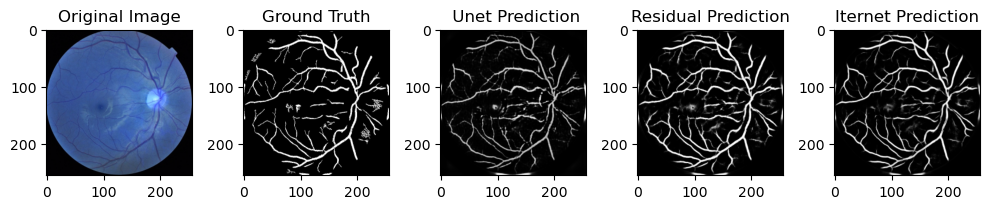

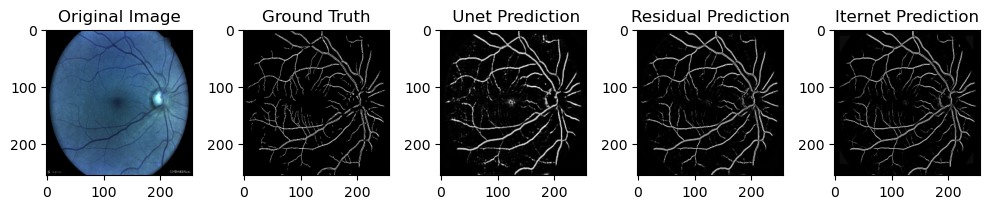

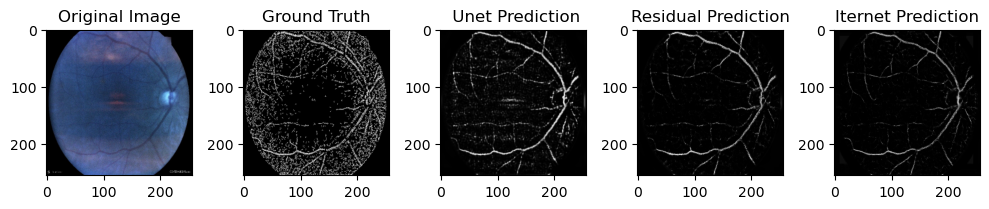

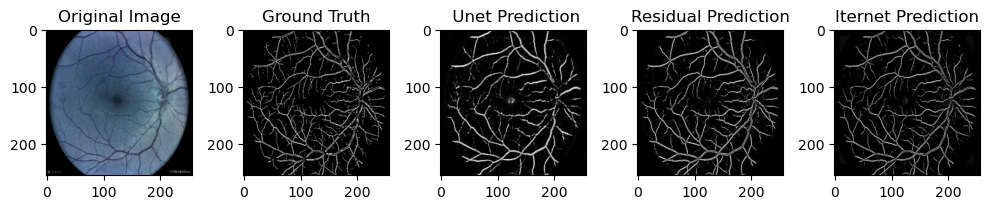

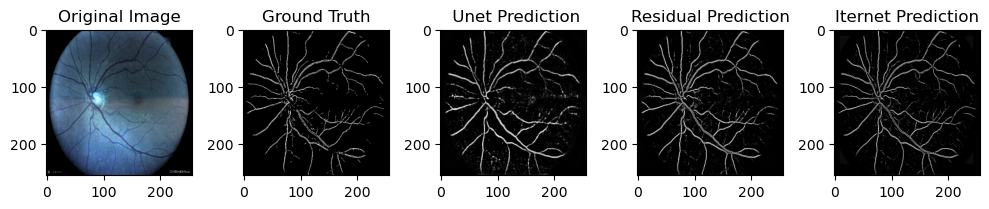

...

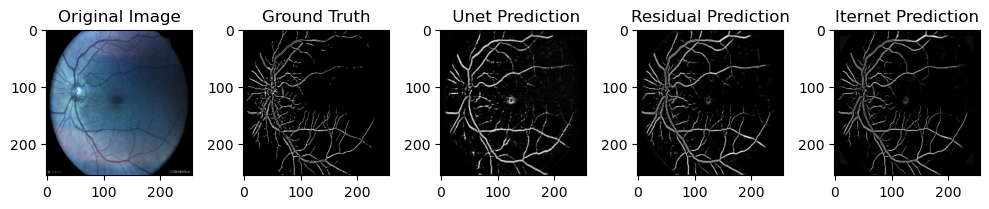

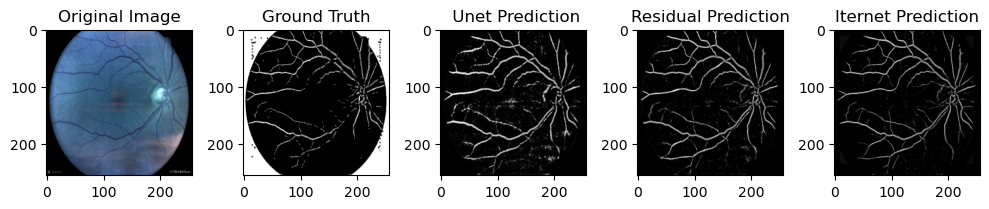

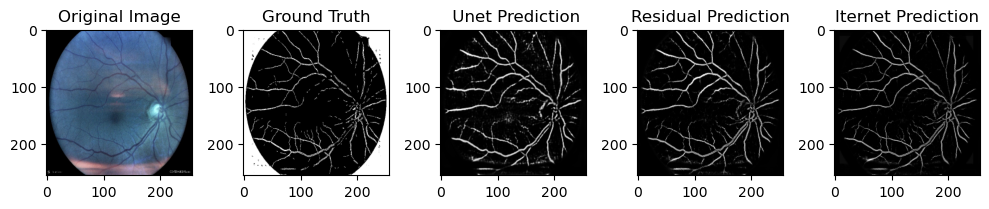

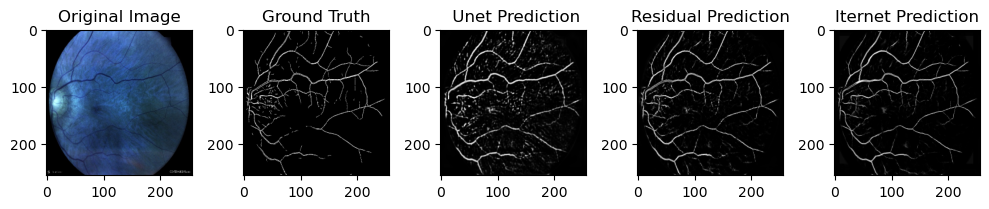

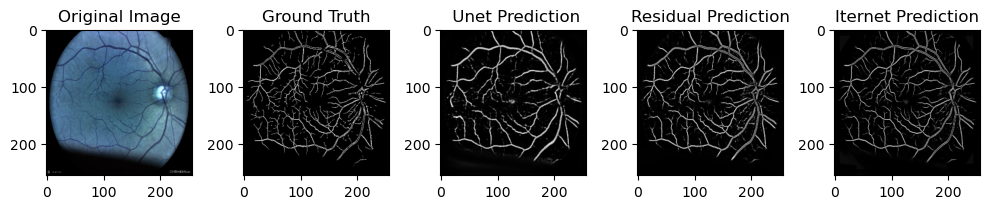

In [34]:
num_images = len(aX_test)

# Iterate over the images and plot them
for i in range(num_images):
    plt.figure(figsize=(10, 5))

    # Plot the original image
    plt.subplot(1, 5, 1)
    plt.imshow(aX_test[i])
    plt.title("Original Image")

    # Plot the ground truth label
    plt.subplot(1, 5, 2)
    plt.imshow(ay_test[i], cmap = 'gray')
    plt.title("Ground Truth")

    # Plot the predicted label
    plt.subplot(1, 5, 3)
    plt.imshow(ay_unet[i], cmap = 'gray')
    plt.title(" Unet Prediction")
    
     # Plot the predicted label
    plt.subplot(1, 5, 4)
    plt.imshow(ay_resid[i], cmap = 'gray')
    plt.title("Residual Prediction")
    
     # Plot the predicted label
    plt.subplot(1, 5, 5)
    plt.imshow(ay_itern[i], cmap = 'gray')
    plt.title("Iternet Prediction")

    plt.tight_layout()
    plt.show()

In [28]:
import numpy as np
from sklearn.metrics import mean_squared_error, mean_absolute_error
from tabulate import tabulate
from sklearn.metrics import jaccard_score, precision_score, recall_score, accuracy_score

# Réduire les tableaux y_test et y_predict à deux dimensions
ay_test_2d = np.round(ay_test).astype(np.uint8).flatten()
ay_unet_2d = np.round(ay_unet).astype(np.uint8).flatten()
ay_resid_2d = np.round(ay_resid).astype(np.uint8).flatten()
ay_itern_2d = np.round(ay_itern).astype(np.uint8).flatten()


# Calculer le Mean Squared Error (MSE)
mse_unet = mean_squared_error(ay_test_2d, ay_unet_2d)
mse_resid = mean_squared_error(ay_test_2d, ay_resid_2d)
mse_itern = mean_squared_error(ay_test_2d, ay_itern_2d)


# Calculer le Mean Absolute Error (MAE)
mae_unet = mean_absolute_error(ay_test_2d, ay_unet_2d)
mae_resid = mean_absolute_error(ay_test_2d, ay_resid_2d)
mae_itern = mean_absolute_error(ay_test_2d, ay_itern_2d)


# Calculer l'Intersection over Union (IoU)
iou_unet = jaccard_score(ay_test_2d, ay_unet_2d)
iou_resid = jaccard_score(ay_test_2d, ay_resid_2d)
iou_itern = jaccard_score(ay_test_2d, ay_itern_2d)


# Calculer le Dice Coefficient
dice_unet = 2 * np.sum(ay_test_2d * ay_unet_2d) / (np.sum(ay_test_2d) + np.sum(ay_unet_2d))
dice_resid = 2 * np.sum(ay_test_2d * ay_resid_2d) / (np.sum(ay_test_2d) + np.sum(ay_resid_2d))
dice_itern = 2 * np.sum(ay_test_2d * ay_itern_2d) / (np.sum(ay_test_2d) + np.sum(ay_itern_2d))


# Calculer la précision et la sensibilité
precision_unet = precision_score(ay_test_2d, ay_unet_2d)
recall_unet = recall_score(ay_test_2d,ay_unet_2d)

precision_resid = precision_score(ay_test_2d, ay_resid_2d)
recall_resid = recall_score(ay_test_2d,ay_resid_2d)

precision_itern = precision_score(ay_test_2d, ay_itern_2d)
recall_itern = recall_score(ay_test_2d,ay_itern_2d)

# Calculer l'exactitude (accuracy)
accuracy_unet = accuracy_score(ay_test_2d, ay_unet_2d)
accuracy_resid = accuracy_score(ay_test_2d, ay_resid_2d)
accuracy_itern = accuracy_score(ay_test_2d, ay_itern_2d)


# Calculer la ROC AUC
roc_auc_unet = roc_auc_score(ay_test_2d, ay_unet_2d)
roc_auc_resid = roc_auc_score(ay_test_2d, ay_resid_2d)
roc_auc_itern = roc_auc_score(ay_test_2d, ay_itern_2d)

# Créer une liste des métriques et de leurs valeurs
metrics = [
    ["UNET", mse_unet , mae_unet, iou_unet, dice_unet, precision_unet, recall_unet, accuracy_unet, roc_auc_unet],
    ["RESIDUAL UNET", mse_resid, mae_resid, iou_resid, dice_resid, precision_resid, recall_resid, accuracy_resid, roc_auc_resid],
    ["ITERNET", mse_itern, mae_itern, iou_itern, dice_itern, precision_itern, recall_itern, accuracy_itern, roc_auc_itern]
]


print("Resultat pour classe A : ")
print("------------------------------------------------------------------------------------------ \n ")
# Afficher les résultats sous forme de tableau
print(tabulate(metrics, headers=["Model", "MSE", "MAE","JACCARD", "DICE", "PRECISION", "RECALL", "ACCURACY","ROC AUC"]))


Resultat pour classe A : 
------------------------------------------------------------------------------------------ 
 
Model                MSE      MAE    JACCARD      DICE    PRECISION    RECALL    ACCURACY    ROC AUC
-------------  ---------  -------  ---------  --------  -----------  --------  ----------  ---------
UNET           0.0713841  13.3976   0.291598  0.451531     0.60833   0.358998    0.928616   0.669196
RESIDUAL UNET  0.0597464  11.4702   0.381972  0.552793     0.713557  0.451149    0.940254   0.717502
ITERNET        0.0565045  12.5605   0.366012  0.535884     0.817628  0.398549    0.943496   0.695312


- *le modèle RESIDUAL UNET semble avoir les meilleures performances globales, avec des scores Jaccard et Dice plus élevés, une précision plus élevée, un rappel raisonnable et un ROC AUC plus élevé* 


## CLASSE B

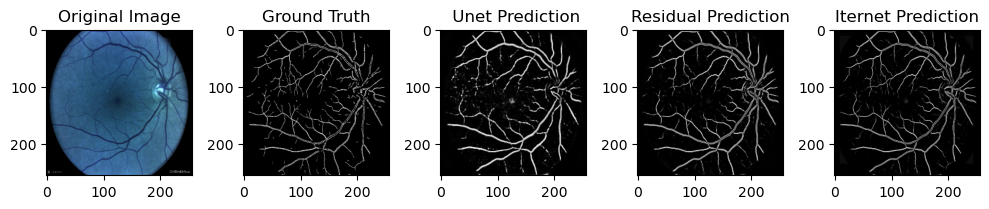

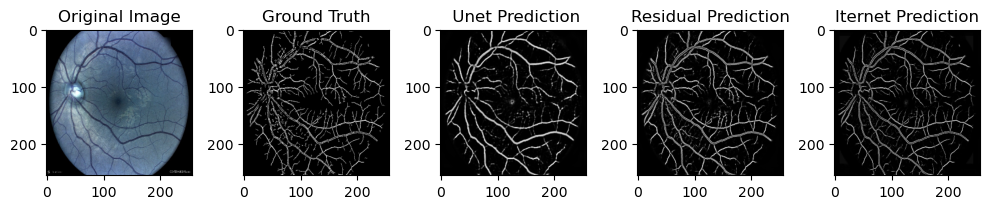

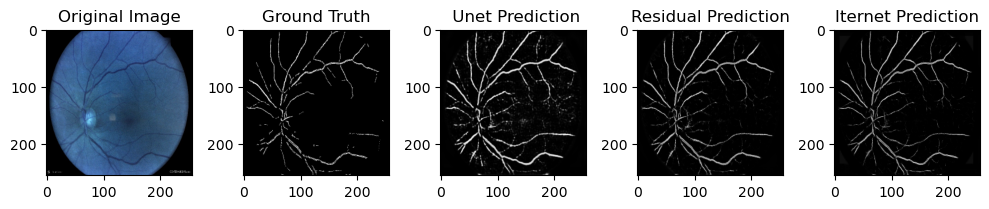

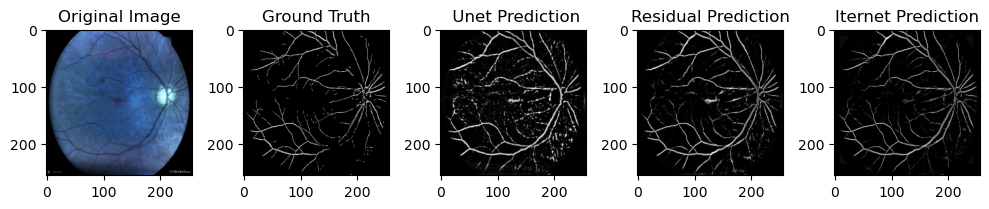

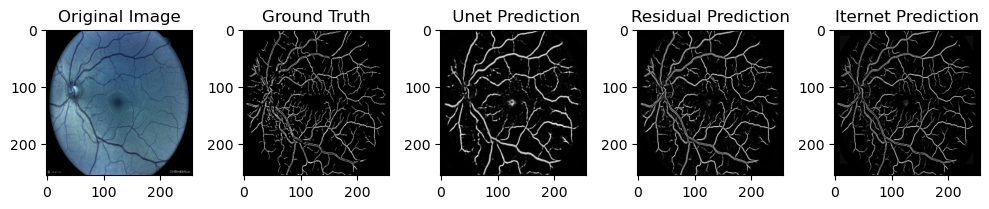

...

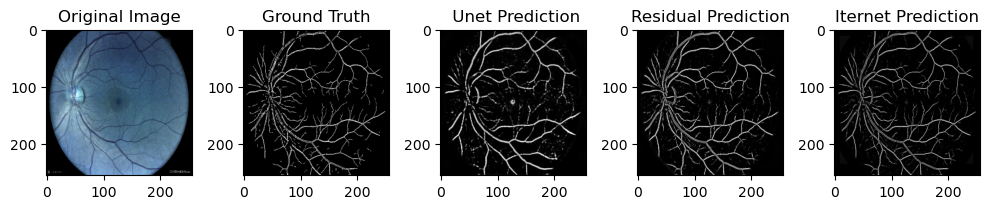

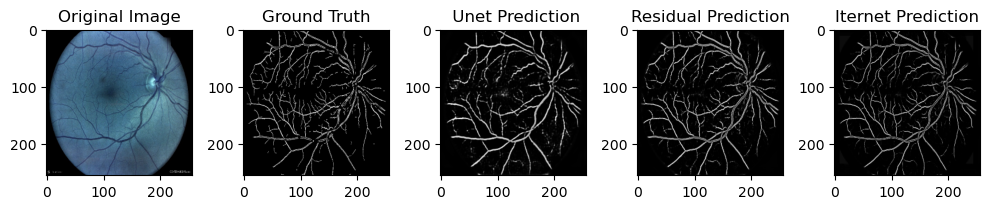

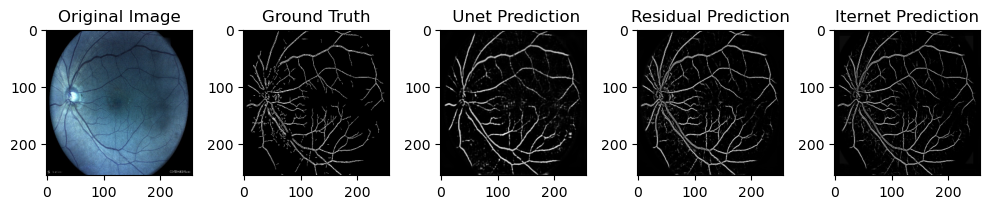

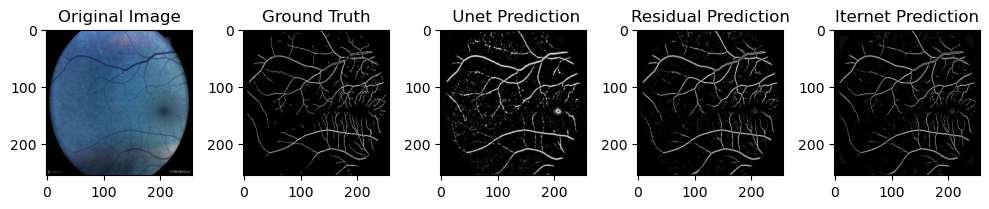

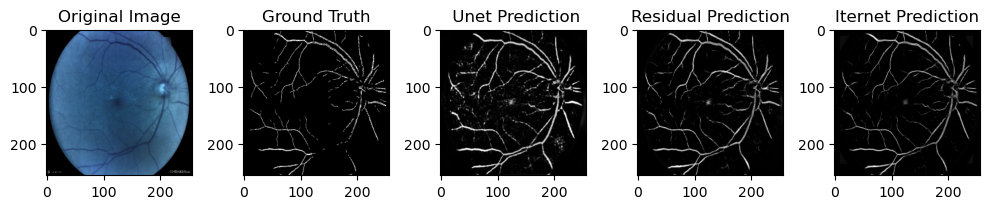

In [51]:
num_images = len(bX_test)

# Iterate over the images and plot them
for i in range(num_images):
    plt.figure(figsize=(10, 5))

    # Plot the original image
    plt.subplot(1, 5, 1)
    plt.imshow(bX_test[i])
    plt.title("Original Image")

    # Plot the ground truth label
    plt.subplot(1, 5, 2)
    plt.imshow(by_test[i], cmap = 'gray')
    plt.title("Ground Truth")

    # Plot the predicted label
    plt.subplot(1, 5, 3)
    plt.imshow(by_unet[i], cmap = 'gray')
    plt.title(" Unet Prediction")
    
     # Plot the predicted label
    plt.subplot(1, 5, 4)
    plt.imshow(by_resid[i], cmap = 'gray')
    plt.title("Residual Prediction")
    
     # Plot the predicted label
    plt.subplot(1, 5, 5)
    plt.imshow(by_itern[i], cmap = 'gray')
    plt.title("Iternet Prediction")

    plt.tight_layout()
    plt.show()

In [29]:
# Réduire les tableaux y_test et y_predict à deux dimensions
by_test_2d = np.round(by_test).astype(np.uint8).flatten()
by_unet_2d = np.round(by_unet).astype(np.uint8).flatten()
by_resid_2d = np.round(by_resid).astype(np.uint8).flatten()
by_itern_2d = np.round(by_itern).astype(np.uint8).flatten()


# Calculer le Mean Squared Error (MSE)
mse_unet = mean_squared_error(by_test_2d, by_unet_2d)
mse_resid = mean_squared_error(by_test_2d, by_resid_2d)
mse_itern = mean_squared_error(by_test_2d, by_itern_2d)


# Calculer le Mean Absolute Error (MAE)
mae_unet = mean_absolute_error(by_test_2d, by_unet_2d)
mae_resid = mean_absolute_error(by_test_2d, by_resid_2d)
mae_itern = mean_absolute_error(by_test_2d, by_itern_2d)


# Calculer l'Intersection over Union (IoU)
iou_unet = jaccard_score(by_test_2d, by_unet_2d)
iou_resid = jaccard_score(by_test_2d, by_resid_2d)
iou_itern = jaccard_score(by_test_2d, by_itern_2d)


# Calculer le Dice Coefficient
dice_unet = 2 * np.sum(by_test_2d * by_unet_2d) / (np.sum(by_test_2d) + np.sum(by_unet_2d))
dice_resid = 2 * np.sum(by_test_2d * by_resid_2d) / (np.sum(by_test_2d) + np.sum(by_resid_2d))
dice_itern = 2 * np.sum(by_test_2d * by_itern_2d) / (np.sum(by_test_2d) + np.sum(by_itern_2d))


# Calculer la précision et la sensibilité
precision_unet = precision_score(by_test_2d, by_unet_2d)
recall_unet = recall_score(by_test_2d,by_unet_2d)

precision_resid = precision_score(by_test_2d, by_resid_2d)
recall_resid = recall_score(by_test_2d,by_resid_2d)

precision_itern = precision_score(by_test_2d, by_itern_2d)
recall_itern = recall_score(by_test_2d,by_itern_2d)

# Calculer l'exactitude (accuracy)
accuracy_unet = accuracy_score(by_test_2d, by_unet_2d)
accuracy_resid = accuracy_score(by_test_2d, by_resid_2d)
accuracy_itern = accuracy_score(by_test_2d, by_itern_2d)

# Calculer la ROC AUC
roc_auc_unet = roc_auc_score(by_test_2d, by_unet_2d)
roc_auc_resid = roc_auc_score(by_test_2d, by_resid_2d)
roc_auc_itern = roc_auc_score(by_test_2d, by_itern_2d)

# Créer une liste des métriques et de leurs valeurs
metrics = [
    ["UNET", mse_unet , mae_unet, iou_unet, dice_unet, precision_unet, recall_unet, accuracy_unet, roc_auc_unet],
    ["RESIDUAL UNET", mse_resid, mae_resid, iou_resid, dice_resid, precision_resid, recall_resid, accuracy_resid, roc_auc_resid],
    ["ITERNET", mse_itern, mae_itern, iou_itern, dice_itern, precision_itern, recall_itern, accuracy_itern, roc_auc_itern]
]

print("Resultat pour classe B : ")
print("------------------------------------------------------------------------------------------ \n ")
# Afficher les résultats sous forme de tableau
print(tabulate(metrics, headers=["Model", "MSE", "MAE","JACCARD", "DICE", "PRECISION", "RECALL", "ACCURACY","ROC AUC"]))


Resultat pour classe B : 
------------------------------------------------------------------------------------------ 
 
Model                MSE      MAE    JACCARD      DICE    PRECISION    RECALL    ACCURACY    ROC AUC
-------------  ---------  -------  ---------  --------  -----------  --------  ----------  ---------
UNET           0.0434125  5.50787   0.396738  0.568092     0.565923  0.570278    0.956587   0.773613
RESIDUAL UNET  0.0283991  3.60118   0.559     0.717126     0.715224  0.719039    0.971601   0.851975
ITERNET        0.0251172  4.59331   0.560859  0.718654     0.818108  0.64076     0.974883   0.816626


- le modèle RESIDUAL UNET semble être une option solide pour la classe B, avec de bons scores Jaccard et Dice, ainsi qu'un score ROC AUC élevé.


1. Jaccard et Dice : Les scores Jaccard et Dice mesurent la similarité entre le masque prédit et le masque de référence. Un score plus élevé indique une meilleure correspondance. Dans ce cas, le modèle RESIDUAL UNET a les meilleurs scores Jaccard (0.559) et Dice (0.717126).

2. Précision et rappel : La précision et le rappel évaluent la capacité du modèle à trouver les pixels positifs (vaisseaux sanguins) et à éviter les faux positifs. Dans ce cas, le modèle ITERNET a une précision plus élevée (0.818108), tandis que le modèle RESIDUAL UNET a un rappel légèrement plus élevé (0.719039).

3. ROC AUC : Le score ROC AUC évalue la capacité du modèle à discriminer entre les pixels positifs et négatifs en fonction du seuil de classification. Un score plus élevé indique une meilleure capacité de discrimination. Dans ce cas, le modèle RESIDUAL UNET a le meilleur score ROC AUC (0.851975).

## CLASSE C

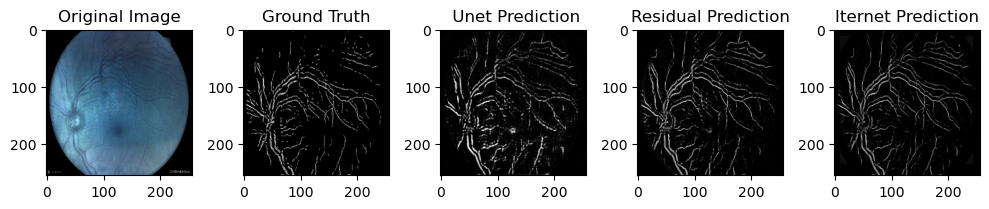

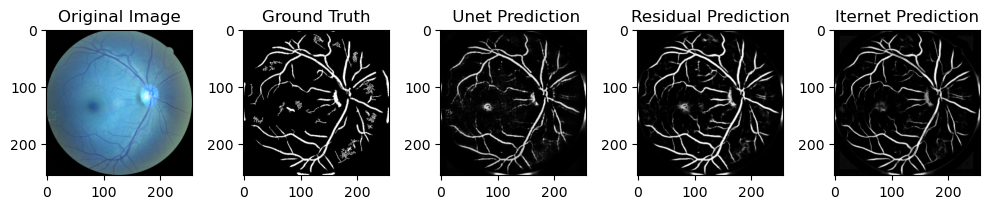

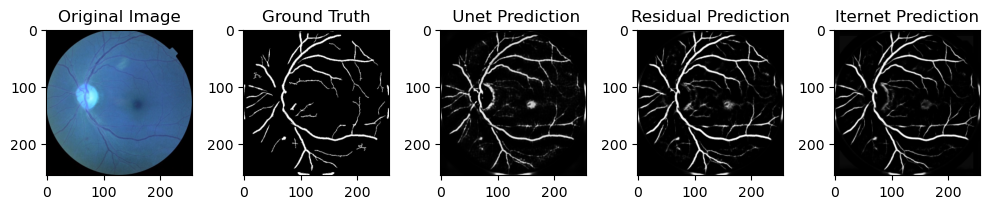

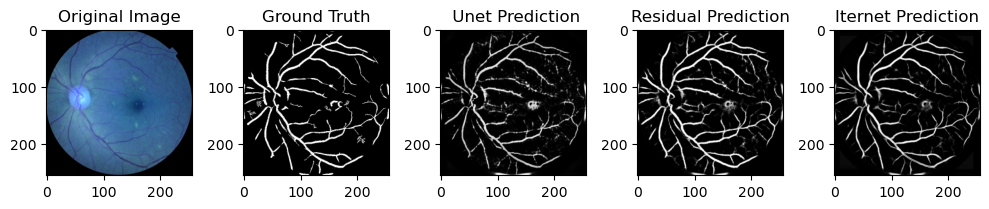

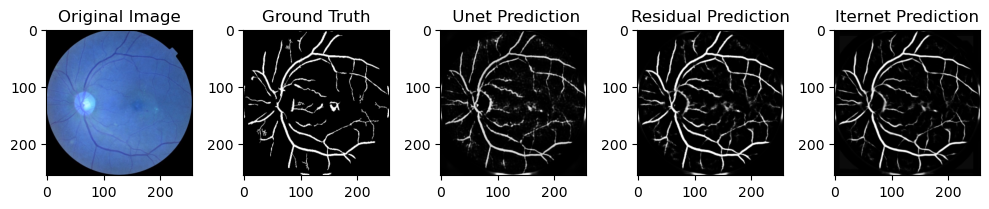

...

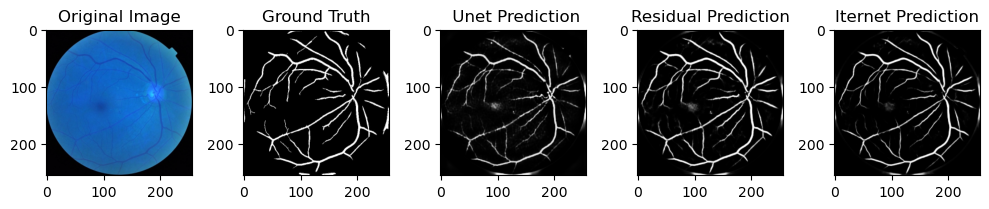

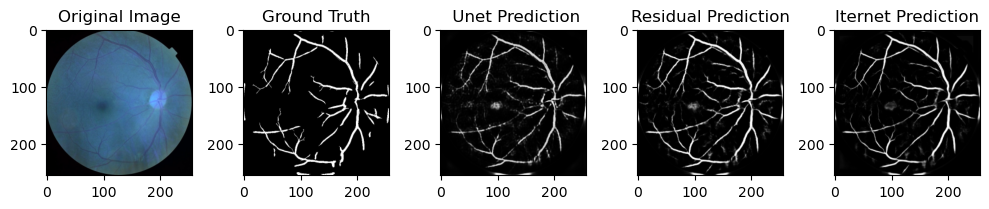

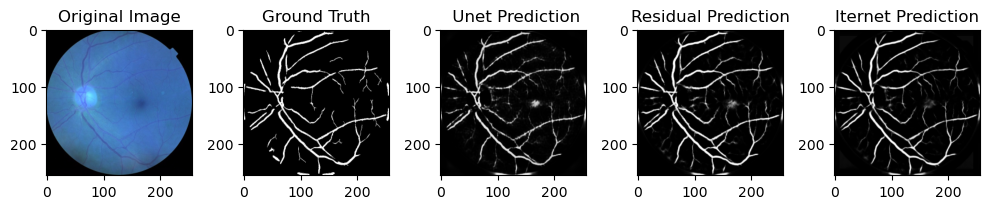

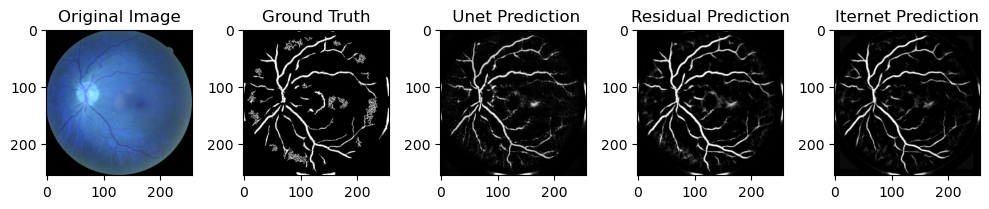

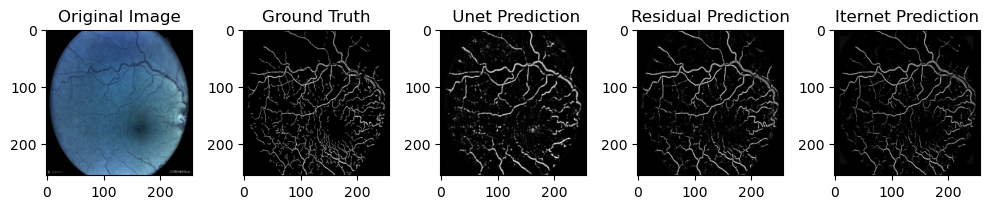

In [56]:
num_images = len(cX_test)

# Iterate over the images and plot them
for i in range(num_images):
    plt.figure(figsize=(10, 5))

    # Plot the original image
    plt.subplot(1, 5, 1)
    plt.imshow(cX_test[i])
    plt.title("Original Image")

    # Plot the ground truth label
    plt.subplot(1, 5, 2)
    plt.imshow(cy_test[i], cmap = 'gray')
    plt.title("Ground Truth")

    # Plot the predicted label
    plt.subplot(1, 5, 3)
    plt.imshow(cy_unet[i], cmap = 'gray')
    plt.title(" Unet Prediction")
    
     # Plot the predicted label
    plt.subplot(1, 5, 4)
    plt.imshow(cy_resid[i], cmap = 'gray')
    plt.title("Residual Prediction")
    
     # Plot the predicted label
    plt.subplot(1, 5, 5)
    plt.imshow(cy_itern[i], cmap = 'gray')
    plt.title("Iternet Prediction")

    plt.tight_layout()
    plt.show()

In [30]:
# Réduire les tableaux y_test et y_predict à deux dimensions
cy_test_2d = np.round(cy_test).astype(np.uint8).flatten()
cy_unet_2d = np.round(cy_unet).astype(np.uint8).flatten()
cy_resid_2d = np.round(cy_resid).astype(np.uint8).flatten()
cy_itern_2d = np.round(cy_itern).astype(np.uint8).flatten()


# Calculer le Mean Squared Error (MSE)
mse_unet = mean_squared_error(cy_test_2d, cy_unet_2d)
mse_resid = mean_squared_error(cy_test_2d, cy_resid_2d)
mse_itern = mean_squared_error(cy_test_2d, cy_itern_2d)


# Calculer le Mean Absolute Error (MAE)
mae_unet = mean_absolute_error(cy_test_2d, cy_unet_2d)
mae_resid = mean_absolute_error(cy_test_2d, cy_resid_2d)
mae_itern = mean_absolute_error(cy_test_2d, cy_itern_2d)


# Calculer l'Intersection over Union (IoU)
iou_unet = jaccard_score(cy_test_2d, cy_unet_2d)
iou_resid = jaccard_score(cy_test_2d, cy_resid_2d)
iou_itern = jaccard_score(cy_test_2d, cy_itern_2d)


# Calculer le Dice Coefficient
dice_unet = 2 * np.sum(cy_test_2d * cy_unet_2d) / (np.sum(cy_test_2d) + np.sum(cy_unet_2d))
dice_resid = 2 * np.sum(cy_test_2d * cy_resid_2d) / (np.sum(cy_test_2d) + np.sum(cy_resid_2d))
dice_itern = 2 * np.sum(cy_test_2d * cy_itern_2d) / (np.sum(cy_test_2d) + np.sum(cy_itern_2d))


# Calculer la précision et la sensibilité
precision_unet = precision_score(cy_test_2d, cy_unet_2d)
recall_unet = recall_score(cy_test_2d,cy_unet_2d)

precision_resid = precision_score(cy_test_2d, cy_resid_2d)
recall_resid = recall_score(cy_test_2d,cy_resid_2d)

precision_itern = precision_score(cy_test_2d, cy_itern_2d)
recall_itern = recall_score(cy_test_2d,cy_itern_2d)

# Calculer l'exactitude (accuracy)
accuracy_unet = accuracy_score(cy_test_2d, cy_unet_2d)
accuracy_resid = accuracy_score(cy_test_2d, cy_resid_2d)
accuracy_itern = accuracy_score(cy_test_2d, cy_itern_2d)


# Calculer la ROC AUC
roc_auc_unet = roc_auc_score(cy_test_2d,cy_unet_2d)
roc_auc_resid = roc_auc_score(cy_test_2d, cy_resid_2d)
roc_auc_itern = roc_auc_score(cy_test_2d, cy_itern_2d)

# Créer une liste des métriques et de leurs valeurs
metrics = [
    ["UNET", mse_unet , mae_unet, iou_unet, dice_unet, precision_unet, recall_unet, accuracy_unet, roc_auc_unet],
    ["RESIDUAL UNET", mse_resid, mae_resid, iou_resid, dice_resid, precision_resid, recall_resid, accuracy_resid, roc_auc_resid],
    ["ITERNET", mse_itern, mae_itern, iou_itern, dice_itern, precision_itern, recall_itern, accuracy_itern, roc_auc_itern]
]


print("Resultat pour classe C : ")
print("------------------------------------------------------------------------------------------ \n ")
# Afficher les résultats sous forme de tableau
print(tabulate(metrics, headers=["Model", "MSE", "MAE","JACCARD", "DICE", "PRECISION", "RECALL", "ACCURACY","ROC AUC"]))


Resultat pour classe C : 
------------------------------------------------------------------------------------------ 
 
Model                MSE      MAE    JACCARD      DICE    PRECISION    RECALL    ACCURACY    ROC AUC
-------------  ---------  -------  ---------  --------  -----------  --------  ----------  ---------
UNET           0.042124   8.64731   0.522622  0.686476     0.848325  0.57649     0.957876   0.783764
RESIDUAL UNET  0.0301888  4.81918   0.669451  0.802002     0.843608  0.764306    0.969811   0.875993
ITERNET        0.0310558  6.68745   0.633968  0.775986     0.917298  0.672401    0.968944   0.833565


- En prenant en compte ces métriques, le modèle RESIDUAL UNET semble être le meilleur choix pour la classe C, avec de bons scores Jaccard et Dice, ainsi qu'un score ROC AUC élevé.

##  CLASSE D

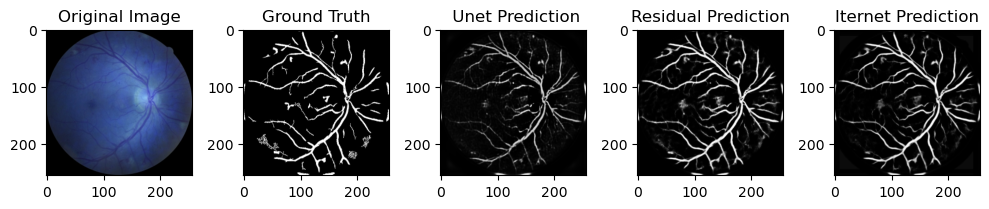

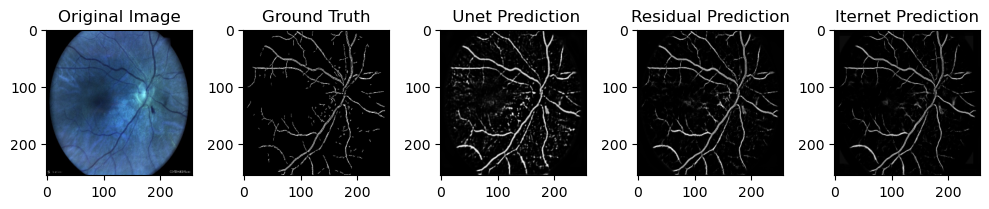

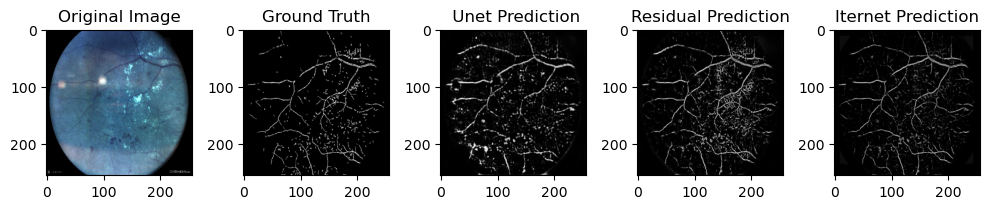

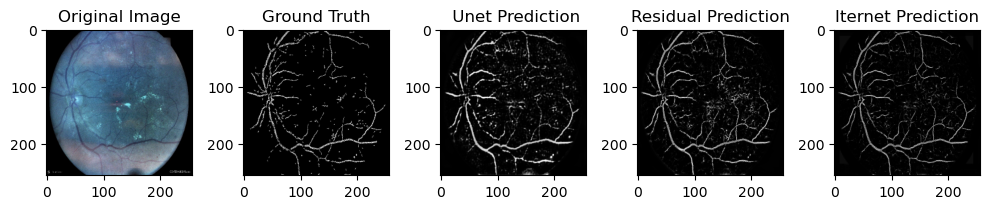

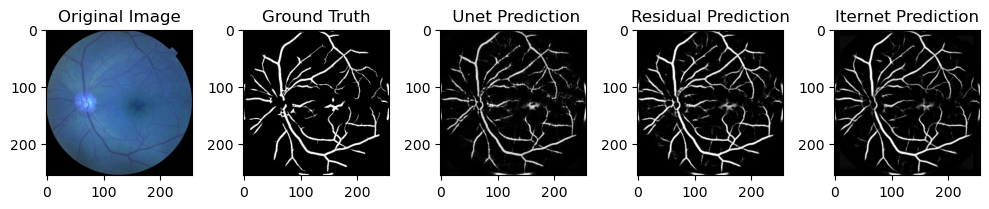

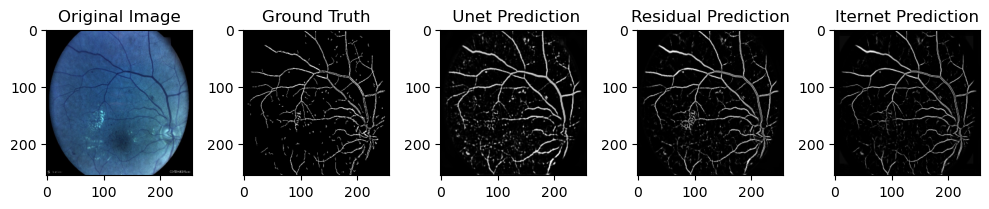

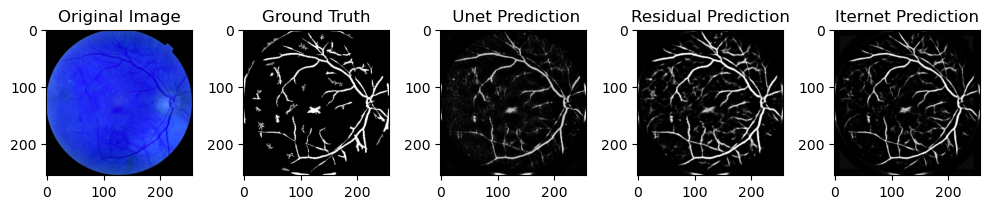

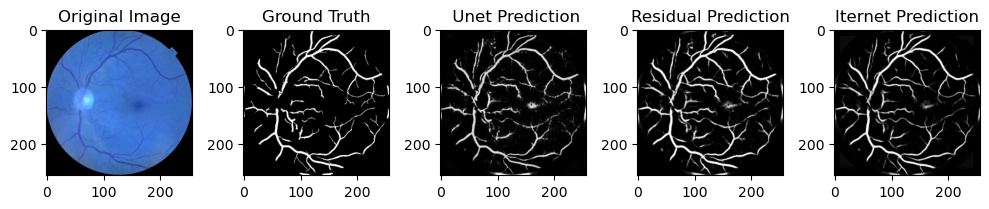

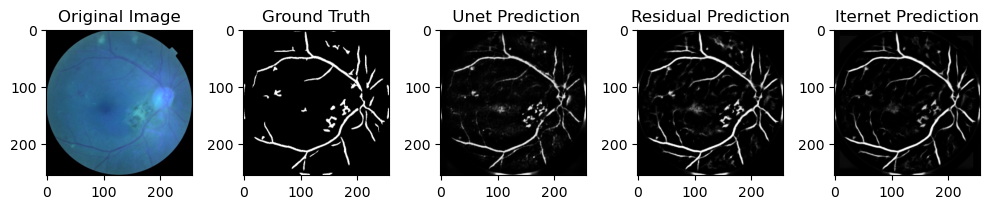

In [58]:
num_images = len(dX_test)

# Iterate over the images and plot them
for i in range(num_images):
    plt.figure(figsize=(10, 5))

    # Plot the original image
    plt.subplot(1, 5, 1)
    plt.imshow(dX_test[i])
    plt.title("Original Image")

    # Plot the ground truth label
    plt.subplot(1, 5, 2)
    plt.imshow(dy_test[i], cmap = 'gray')
    plt.title("Ground Truth")

    # Plot the predicted label
    plt.subplot(1, 5, 3)
    plt.imshow(dy_unet[i], cmap = 'gray')
    plt.title(" Unet Prediction")
    
     # Plot the predicted label
    plt.subplot(1, 5, 4)
    plt.imshow(dy_resid[i], cmap = 'gray')
    plt.title("Residual Prediction")
    
     # Plot the predicted label
    plt.subplot(1, 5, 5)
    plt.imshow(dy_itern[i], cmap = 'gray')
    plt.title("Iternet Prediction")

    plt.tight_layout()
    plt.show()

In [24]:
# Réduire les tableaux y_test et y_predict à deux dimensions
cy_test_2d = np.round(dy_test).astype(np.uint8).flatten()
cy_unet_2d = np.round(dy_unet).astype(np.uint8).flatten()
cy_resid_2d = np.round(dy_resid).astype(np.uint8).flatten()
cy_itern_2d = np.round(dy_itern).astype(np.uint8).flatten()


# Calculer le Mean Squared Error (MSE)
mse_unet = mean_squared_error(cy_test_2d, cy_unet_2d)
mse_resid = mean_squared_error(cy_test_2d, cy_resid_2d)
mse_itern = mean_squared_error(cy_test_2d, cy_itern_2d)


# Calculer le Mean Absolute Error (MAE)
mae_unet = mean_absolute_error(cy_test_2d, cy_unet_2d)
mae_resid = mean_absolute_error(cy_test_2d, cy_resid_2d)
mae_itern = mean_absolute_error(cy_test_2d, cy_itern_2d)


# Calculer l'Intersection over Union (IoU)
iou_unet = jaccard_score(cy_test_2d, cy_unet_2d)
iou_resid = jaccard_score(cy_test_2d, cy_resid_2d)
iou_itern = jaccard_score(cy_test_2d, cy_itern_2d)


# Calculer le Dice Coefficient
dice_unet = 2 * np.sum(cy_test_2d * cy_unet_2d) / (np.sum(cy_test_2d) + np.sum(cy_unet_2d))
dice_resid = 2 * np.sum(cy_test_2d * cy_resid_2d) / (np.sum(cy_test_2d) + np.sum(cy_resid_2d))
dice_itern = 2 * np.sum(cy_test_2d * cy_itern_2d) / (np.sum(cy_test_2d) + np.sum(cy_itern_2d))


# Calculer la précision et la sensibilité
precision_unet = precision_score(cy_test_2d, cy_unet_2d)
recall_unet = recall_score(cy_test_2d,cy_unet_2d)

precision_resid = precision_score(cy_test_2d, cy_resid_2d)
recall_resid = recall_score(cy_test_2d,cy_resid_2d)

precision_itern = precision_score(cy_test_2d, cy_itern_2d)
recall_itern = recall_score(cy_test_2d,cy_itern_2d)

# Calculer l'exactitude (accuracy)
accuracy_unet = accuracy_score(cy_test_2d, cy_unet_2d)
accuracy_resid = accuracy_score(cy_test_2d, cy_resid_2d)
accuracy_itern = accuracy_score(cy_test_2d, cy_itern_2d)


# Calculer la ROC AUC
roc_auc_unet = roc_auc_score(cy_test_2d, cy_unet_2d)
roc_auc_resid = roc_auc_score(cy_test_2d, cy_resid_2d)
roc_auc_itern = roc_auc_score(cy_test_2d, cy_itern_2d)

# Créer une liste des métriques et de leurs valeurs
metrics = [
    ["UNET", mse_unet , mae_unet, iou_unet, dice_unet, precision_unet, recall_unet, accuracy_unet, roc_auc_unet],
    ["RESIDUAL UNET", mse_resid, mae_resid, iou_resid, dice_resid, precision_resid, recall_resid, accuracy_resid, roc_auc_resid],
    ["ITERNET", mse_itern, mae_itern, iou_itern, dice_itern, precision_itern, recall_itern, accuracy_itern, roc_auc_itern]
]



print("Resultat pour classe D : ")
print("------------------------------------------------------------------------------------------ \n ")
# Afficher les résultats sous forme de tableau
print(tabulate(metrics, headers=["Model", "MSE", "MAE","JACCARD", "DICE", "PCRECISION", "RECALL", "ACCURACY","ROC AUC"]))


Resultat pour classe D : 
------------------------------------------------------------------------------------------ 
 
Model                MSE      MAE    JACCARD      DICE    PCRECISION    RECALL    ACCURACY    ROC AUC
-------------  ---------  -------  ---------  --------  ------------  --------  ----------  ---------
UNET           0.0416785  7.77376   0.463206  0.633139      0.761934  0.54159     0.958321   0.764777
RESIDUAL UNET  0.0299208  4.31734   0.623389  0.768009      0.791567  0.745813    0.970079   0.865922
ITERNET        0.029402   5.99329   0.593493  0.744896      0.878766  0.646421    0.970598   0.820039


- le modèle RESIDUAL UNET semble être le meilleur choix pour la classe D, avec de bons scores Jaccard et Dice, ainsi qu'un score ROC AUC élevé.

## CLASSE E

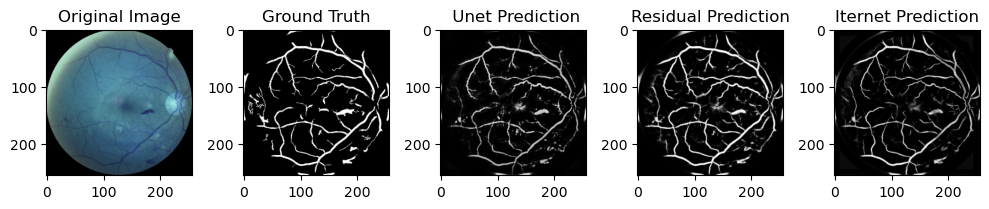

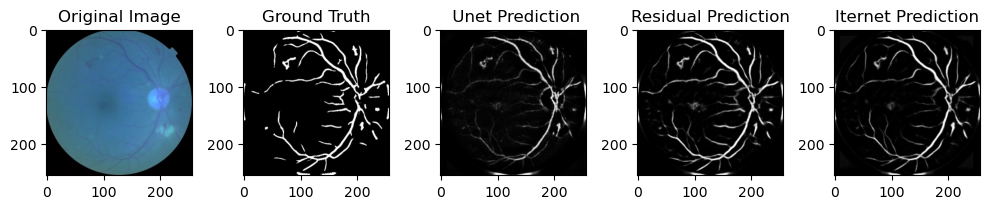

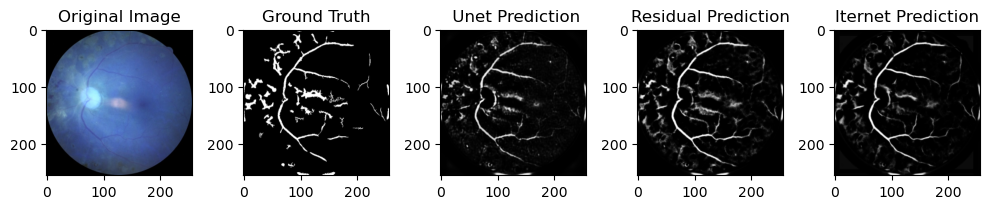

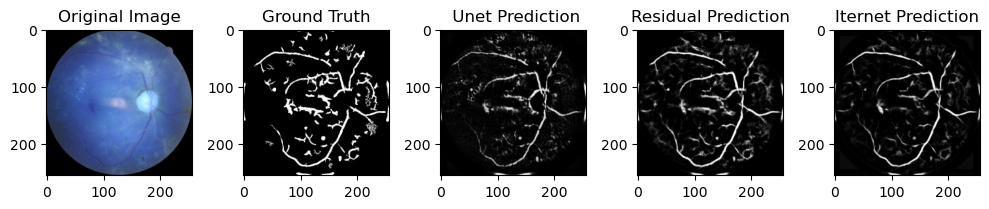

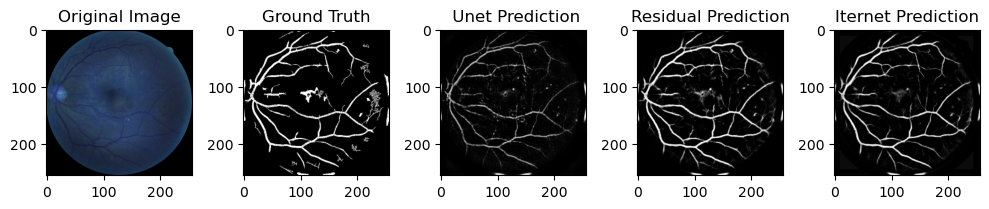

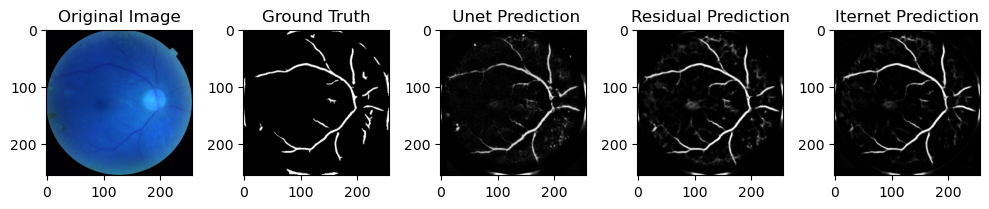

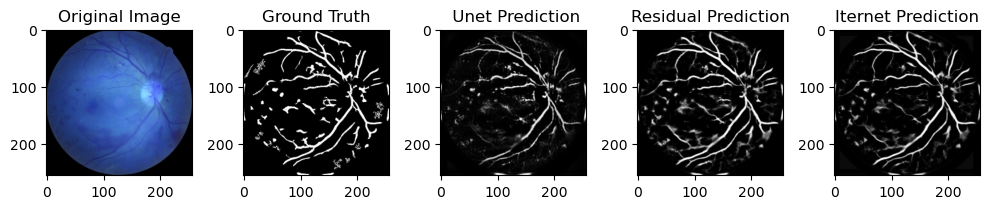

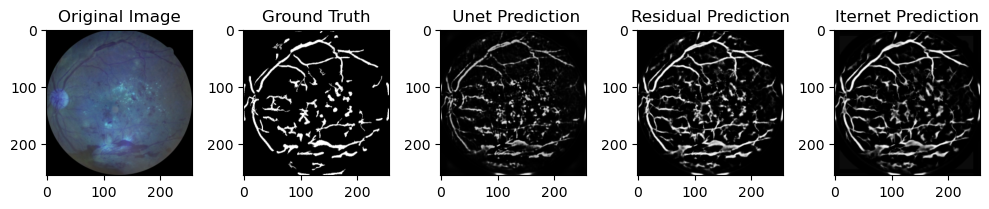

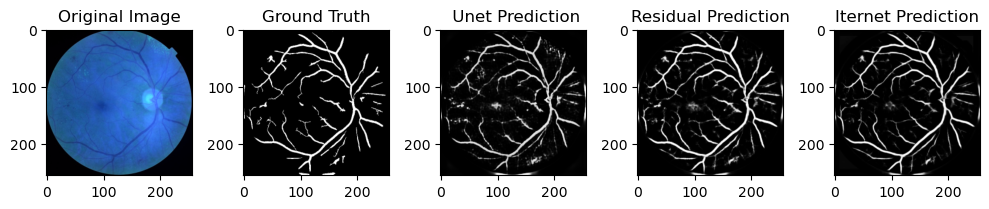

In [61]:
num_images = len(eX_test)

# Iterate over the images and plot them
for i in range(num_images):
    plt.figure(figsize=(10, 5))

    # Plot the original image
    plt.subplot(1, 5, 1)
    plt.imshow(eX_test[i])
    plt.title("Original Image")

    # Plot the ground truth label
    plt.subplot(1, 5, 2)
    plt.imshow(ey_test[i], cmap = 'gray')
    plt.title("Ground Truth")

    # Plot the predicted label
    plt.subplot(1, 5, 3)
    plt.imshow(ey_unet[i], cmap = 'gray')
    plt.title(" Unet Prediction")
    
     # Plot the predicted label
    plt.subplot(1, 5, 4)
    plt.imshow(ey_resid[i], cmap = 'gray')
    plt.title("Residual Prediction")
    
     # Plot the predicted label
    plt.subplot(1, 5, 5)
    plt.imshow(ey_itern[i], cmap = 'gray')
    plt.title("Iternet Prediction")

    plt.tight_layout()
    plt.show()

In [31]:
# Réduire les tableaux y_test et y_predict à deux dimensions
cy_test_2d = np.round(dy_test).astype(np.uint8).flatten()
cy_unet_2d = np.round(dy_unet).astype(np.uint8).flatten()
cy_resid_2d = np.round(dy_resid).astype(np.uint8).flatten()
cy_itern_2d = np.round(dy_itern).astype(np.uint8).flatten()


# Calculer le Mean Squared Error (MSE)
mse_unet = mean_squared_error(cy_test_2d, cy_unet_2d)
mse_resid = mean_squared_error(cy_test_2d, cy_resid_2d)
mse_itern = mean_squared_error(cy_test_2d, cy_itern_2d)


# Calculer le Mean Absolute Error (MAE)
mae_unet = mean_absolute_error(cy_test_2d, cy_unet_2d)
mae_resid = mean_absolute_error(cy_test_2d, cy_resid_2d)
mae_itern = mean_absolute_error(cy_test_2d, cy_itern_2d)


# Calculer l'Intersection over Union (IoU)
iou_unet = jaccard_score(cy_test_2d, cy_unet_2d)
iou_resid = jaccard_score(cy_test_2d, cy_resid_2d)
iou_itern = jaccard_score(cy_test_2d, cy_itern_2d)


# Calculer le Dice Coefficient
dice_unet = 2 * np.sum(cy_test_2d * cy_unet_2d) / (np.sum(cy_test_2d) + np.sum(cy_unet_2d))
dice_resid = 2 * np.sum(cy_test_2d * cy_resid_2d) / (np.sum(cy_test_2d) + np.sum(cy_resid_2d))
dice_itern = 2 * np.sum(cy_test_2d * cy_itern_2d) / (np.sum(cy_test_2d) + np.sum(cy_itern_2d))


# Calculer la précision et la sensibilité
precision_unet = precision_score(cy_test_2d, cy_unet_2d)
recall_unet = recall_score(cy_test_2d,cy_unet_2d)

precision_resid = precision_score(cy_test_2d, cy_resid_2d)
recall_resid = recall_score(cy_test_2d,cy_resid_2d)

precision_itern = precision_score(cy_test_2d, cy_itern_2d)
recall_itern = recall_score(cy_test_2d,cy_itern_2d)

# Calculer l'exactitude (accuracy)
accuracy_unet = accuracy_score(cy_test_2d, cy_unet_2d)
accuracy_resid = accuracy_score(cy_test_2d, cy_resid_2d)
accuracy_itern = accuracy_score(cy_test_2d, cy_itern_2d)


# Calculer la ROC AUC
roc_auc_unet = roc_auc_score(cy_test_2d, cy_unet_2d)
roc_auc_resid = roc_auc_score(cy_test_2d, cy_resid_2d)
roc_auc_itern = roc_auc_score(cy_test_2d, cy_itern_2d)

# Créer une liste des métriques et de leurs valeurs
metrics = [
    ["UNET", mse_unet , mae_unet, iou_unet, dice_unet, precision_unet, recall_unet, accuracy_unet, roc_auc_unet],
    ["RESIDUAL UNET", mse_resid, mae_resid, iou_resid, dice_resid, precision_resid, recall_resid, accuracy_resid, roc_auc_resid],
    ["ITERNET", mse_itern, mae_itern, iou_itern, dice_itern, precision_itern, recall_itern, accuracy_itern, roc_auc_itern]
]



print("Resultat pour classe E : ")
print("------------------------------------------------------------------------------------------ \n ")
# Afficher les résultats sous forme de tableau
print(tabulate(metrics, headers=["Model", "MSE", "MAE","JACCARD", "DICE", "PCRECISION", "RECALL", "ACCURACY","ROC AUC"]))


Resultat pour classe E : 
------------------------------------------------------------------------------------------ 
 
Model                MSE      MAE    JACCARD      DICE    PCRECISION    RECALL    ACCURACY    ROC AUC
-------------  ---------  -------  ---------  --------  ------------  --------  ----------  ---------
UNET           0.0416785  7.77376   0.463206  0.633139      0.761934  0.54159     0.958321   0.764777
RESIDUAL UNET  0.0299208  4.31734   0.623389  0.768009      0.791567  0.745813    0.970079   0.865922
ITERNET        0.029402   5.99329   0.593493  0.744896      0.878766  0.646421    0.970598   0.820039


- En prenant en compte ces métriques, le modèle RESIDUAL UNET semble être le meilleur choix pour la classe E, avec de bons scores Jaccard et Dice, ainsi qu'un score ROC AUC élevé. 

## CLASSE F

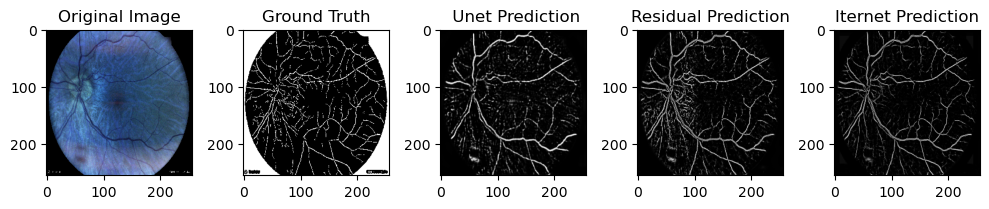

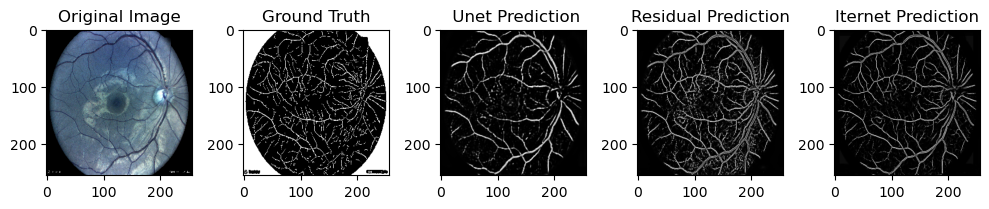

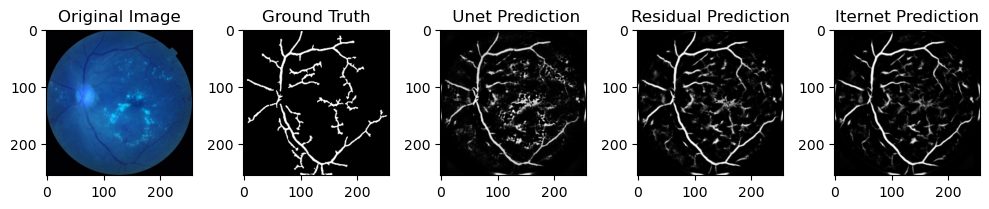

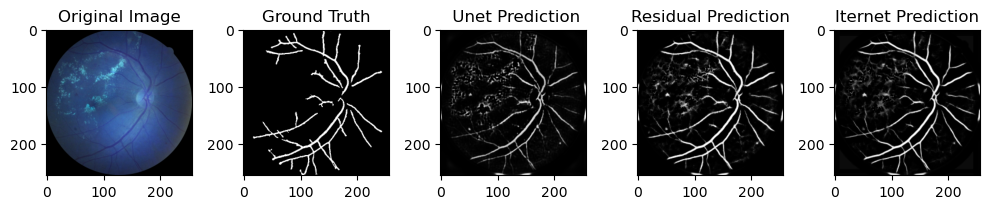

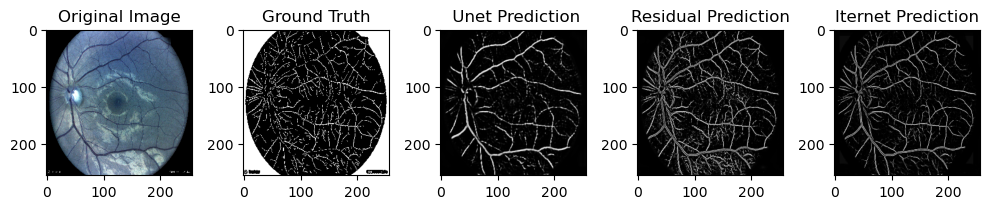

...

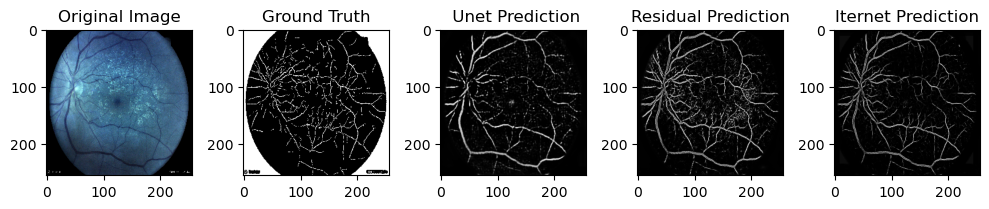

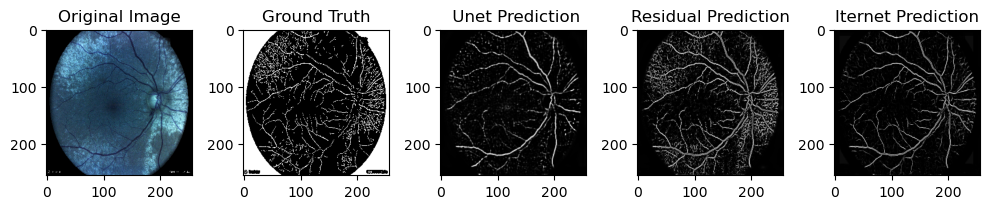

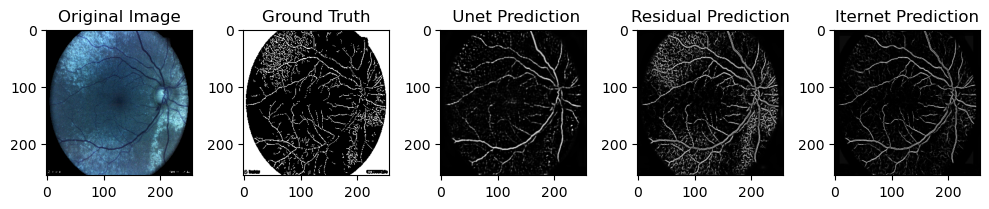

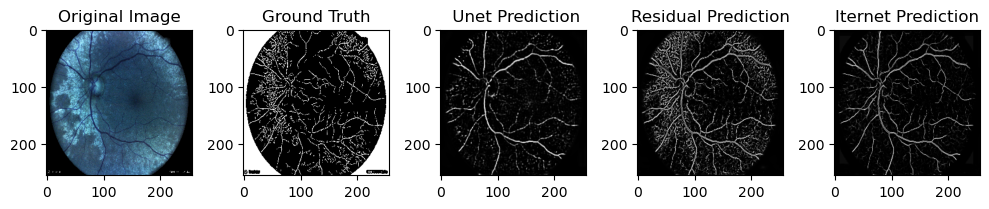

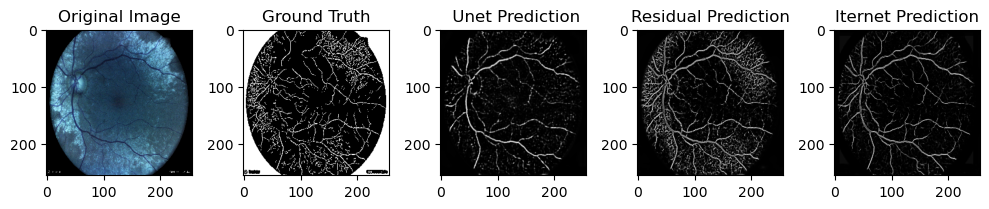

In [74]:
num_images = len(fX_test)

# Iterate over the images and plot them
for i in range(num_images):
    plt.figure(figsize=(10, 5))

    # Plot the original image
    plt.subplot(1, 5, 1)
    plt.imshow(fX_test[i])
    plt.title("Original Image")

    # Plot the ground truth label
    plt.subplot(1, 5, 2)
    plt.imshow(fy_test[i], cmap = 'gray')
    plt.title("Ground Truth")

    # Plot the predicted label
    plt.subplot(1, 5, 3)
    plt.imshow(fy_unet[i], cmap = 'gray')
    plt.title(" Unet Prediction")
    
     # Plot the predicted label
    plt.subplot(1, 5, 4)
    plt.imshow(fy_resid[i], cmap = 'gray')
    plt.title("Residual Prediction")
    
     # Plot the predicted label
    plt.subplot(1, 5, 5)
    plt.imshow(fy_itern[i], cmap = 'gray')
    plt.title("Iternet Prediction")

    plt.tight_layout()
    plt.show()

In [38]:
# Réduire les tableaux y_test et y_predict à deux dimensions
cy_test_2d = np.round(fy_test).astype(np.uint8).flatten()
cy_unet_2d = np.round(fy_unet).astype(np.uint8).flatten()
cy_resid_2d = np.round(fy_resid).astype(np.uint8).flatten()
cy_itern_2d = np.round(fy_itern).astype(np.uint8).flatten()


# Calculer le Mean Squared Error (MSE)
mse_unet = mean_squared_error(cy_test_2d, cy_unet_2d)
mse_resid = mean_squared_error(cy_test_2d, cy_resid_2d)
mse_itern = mean_squared_error(cy_test_2d, cy_itern_2d)


# Calculer le Mean Absolute Error (MAE)
mae_unet = mean_absolute_error(cy_test_2d, cy_unet_2d)
mae_resid = mean_absolute_error(cy_test_2d, cy_resid_2d)
mae_itern = mean_absolute_error(cy_test_2d, cy_itern_2d)


# Calculer l'Intersection over Union (IoU)
iou_unet = jaccard_score(cy_test_2d, cy_unet_2d)
iou_resid = jaccard_score(cy_test_2d, cy_resid_2d)
iou_itern = jaccard_score(cy_test_2d, cy_itern_2d)


# Calculer le Dice Coefficient
dice_unet = 2 * np.sum(cy_test_2d * cy_unet_2d) / (np.sum(cy_test_2d) + np.sum(cy_unet_2d))
dice_resid = 2 * np.sum(cy_test_2d * cy_resid_2d) / (np.sum(cy_test_2d) + np.sum(cy_resid_2d))
dice_itern = 2 * np.sum(cy_test_2d * cy_itern_2d) / (np.sum(cy_test_2d) + np.sum(cy_itern_2d))


# Calculer la précision et la sensibilité
precision_unet = precision_score(cy_test_2d, cy_unet_2d)
recall_unet = recall_score(cy_test_2d,cy_unet_2d)

precision_resid = precision_score(cy_test_2d, cy_resid_2d)
recall_resid = recall_score(cy_test_2d,cy_resid_2d)

precision_itern = precision_score(cy_test_2d, cy_itern_2d)
recall_itern = recall_score(cy_test_2d,cy_itern_2d)

# Calculer l'exactitude (accuracy)
accuracy_unet = accuracy_score(cy_test_2d, cy_unet_2d)
accuracy_resid = accuracy_score(cy_test_2d, cy_resid_2d)
accuracy_itern = accuracy_score(cy_test_2d, cy_itern_2d)


# Calculer la ROC AUC
roc_auc_unet = roc_auc_score(cy_test_2d, cy_unet_2d)
roc_auc_resid = roc_auc_score(cy_test_2d, cy_resid_2d)
roc_auc_itern = roc_auc_score(cy_test_2d, cy_itern_2d)

# Créer une liste des métriques et de leurs valeurs
metrics = [
    ["UNET", mse_unet , mae_unet, iou_unet, dice_unet, precision_unet, recall_unet, accuracy_unet, roc_auc_unet],
    ["RESIDUAL UNET", mse_resid, mae_resid, iou_resid, dice_resid, precision_resid, recall_resid, accuracy_resid, roc_auc_resid],
    ["ITERNET", mse_itern, mae_itern, iou_itern, dice_itern, precision_itern, recall_itern, accuracy_itern, roc_auc_itern]
]



print("Resultat pour classe F : ")
print("------------------------------------------------------------------------------------------ \n ")
# Afficher les résultats sous forme de tableau
print(tabulate(metrics, headers=["Model", "MSE", "MAE","JACCARD", "DICE", "PCRECISION", "RECALL", "ACCURACY","ROC AUC"]))



Resultat pour classe F : 
------------------------------------------------------------------------------------------ 
 
Model               MSE      MAE    JACCARD      DICE    PCRECISION    RECALL    ACCURACY    ROC AUC
-------------  --------  -------  ---------  --------  ------------  --------  ----------  ---------
UNET           0.127773  28.4258   0.449323  0.620046      0.864341  0.483415    0.872227   0.731276
RESIDUAL UNET  0.195847  45.1999   0.16423   0.282127      0.673385  0.178445    0.804153   0.577323
ITERNET        0.198929  48.1012   0.119794  0.213958      0.723678  0.125536    0.801071   0.556178


1. MSE (Mean Squared Error) : Dans ce cas, le modèle UNET a une valeur de MSE inférieure aux autres modèles, ce qui indique une meilleure performance en termes d'erreur quadratique moyenne.

2. MAE (Mean Absolute Error) : Le modèle UNET présente également une valeur de MAE inférieure aux autres modèles, ce qui suggère une meilleure performance en termes d'erreur absolue moyenne.

3. Jaccard et Dice : Les valeurs de Jaccard et de Dice pour le modèle UNET sont plus élevées que celles des autres modèles. Cela indique que le modèle UNET a une meilleure similarité avec la segmentation réelle pour la classe F.4

4. Précision, rappel et précision : Le modèle UNET affiche une précision supérieure à celle des autres modèles, ce qui suggère qu'il est capable de classifier correctement les pixels positifs pour la classe F.

5. ROC AUC : La valeur de ROC AUC est la plus élevée pour le modèle UNET, ce qui suggère qu'il est capable de bien distinguer les classes positives et négatives pour la classe F.

En résumé, en analysant ces métriques, le modèle UNET semble être le meilleur choix pour la classe F, car il présente des valeurs inférieures de MSE et de MAE, ainsi que des valeurs supérieures de Jaccard, Dice, précision, rappel et ROC AUC par rapport aux autres modèles.


## CLASSE G

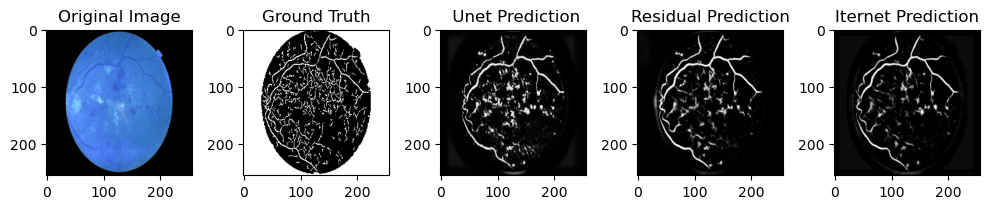

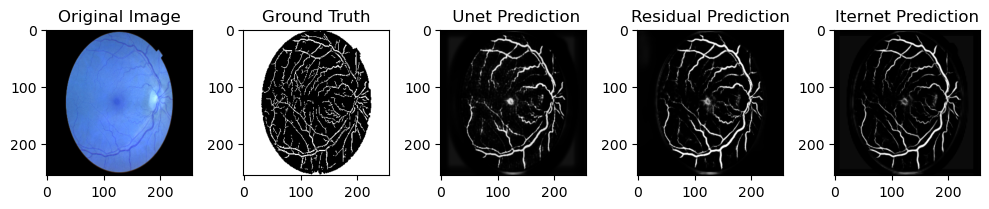

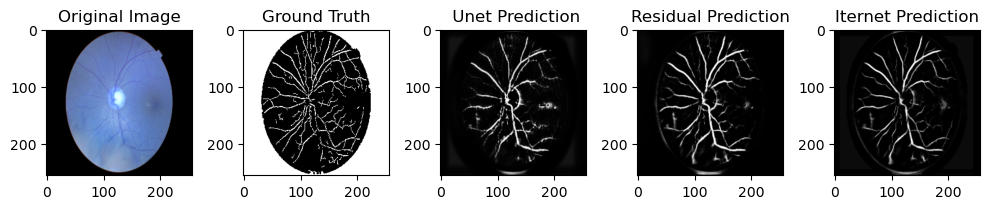

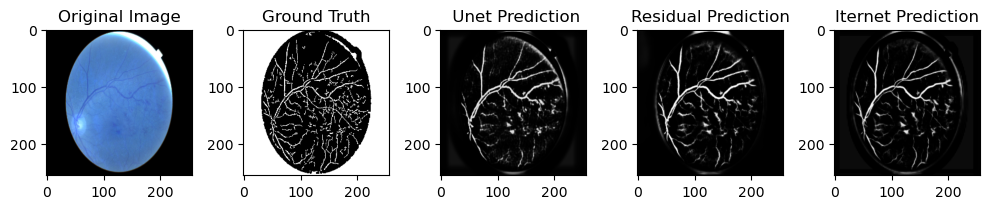

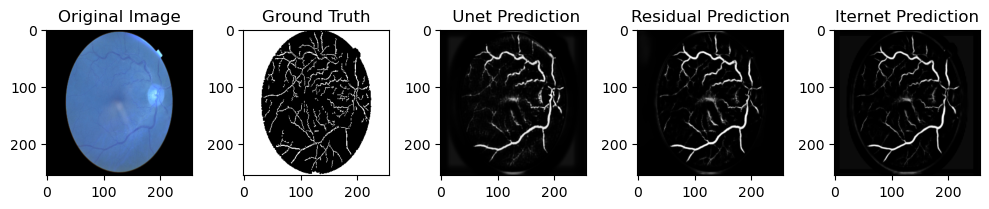

...

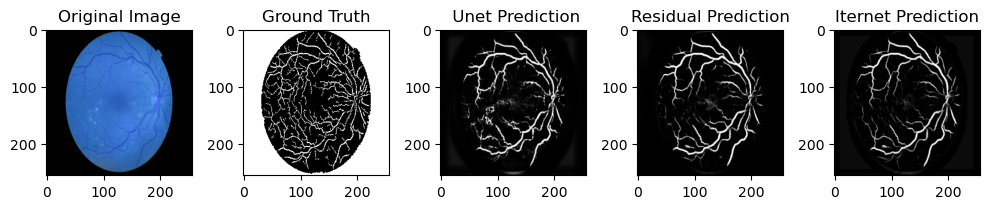

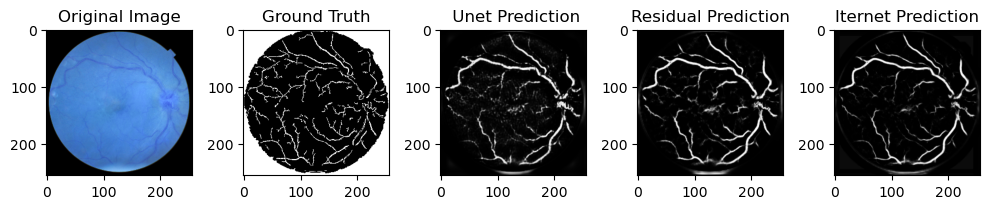

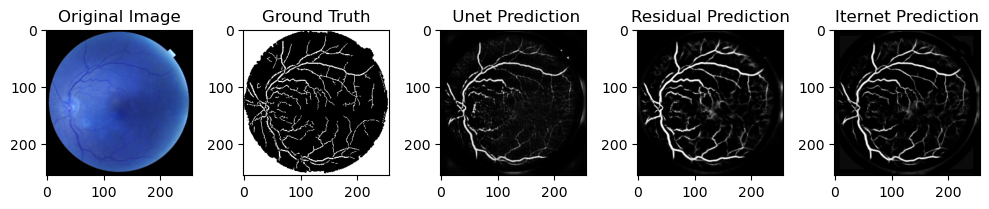

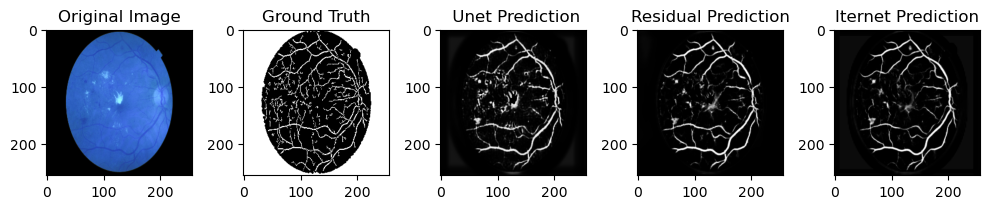

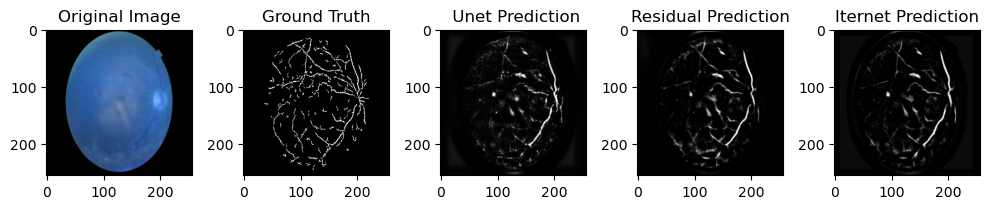

In [41]:
num_images = len(gX_test)

# Iterate over the images and plot them
for i in range(num_images):
    plt.figure(figsize=(10, 5))

    # Plot the original image
    plt.subplot(1, 5, 1)
    plt.imshow(gX_test[i])
    plt.title("Original Image")

    # Plot the ground truth label
    plt.subplot(1, 5, 2)
    plt.imshow(gy_test[i], cmap = 'gray')
    plt.title("Ground Truth")

    # Plot the predicted label
    plt.subplot(1, 5, 3)
    plt.imshow(gy_unet[i], cmap = 'gray')
    plt.title(" Unet Prediction")
    
     # Plot the predicted label
    plt.subplot(1, 5, 4)
    plt.imshow(gy_resid[i], cmap = 'gray')
    plt.title("Residual Prediction")
    
     # Plot the predicted label
    plt.subplot(1, 5, 5)
    plt.imshow(gy_itern[i], cmap = 'gray')
    plt.title("Iternet Prediction")

    plt.tight_layout()
    plt.show()

In [36]:
# Réduire les tableaux y_test et y_predict à deux dimensions
cy_test_2d = np.round(gy_test).astype(np.uint8).flatten()
cy_unet_2d = np.round(gy_unet).astype(np.uint8).flatten()
cy_resid_2d = np.round(gy_resid).astype(np.uint8).flatten()
cy_itern_2d = np.round(gy_itern).astype(np.uint8).flatten()


# Calculer le Mean Squared Error (MSE)
mse_unet = mean_squared_error(cy_test_2d, cy_unet_2d)
mse_resid = mean_squared_error(cy_test_2d, cy_resid_2d)
mse_itern = mean_squared_error(cy_test_2d, cy_itern_2d)


# Calculer le Mean Absolute Error (MAE)
mae_unet = mean_absolute_error(cy_test_2d, cy_unet_2d)
mae_resid = mean_absolute_error(cy_test_2d, cy_resid_2d)
mae_itern = mean_absolute_error(cy_test_2d, cy_itern_2d)


# Calculer l'Intersection over Union (IoU)
iou_unet = jaccard_score(cy_test_2d, cy_unet_2d)
iou_resid = jaccard_score(cy_test_2d, cy_resid_2d)
iou_itern = jaccard_score(cy_test_2d, cy_itern_2d)


# Calculer le Dice Coefficient
dice_unet = 2 * np.sum(cy_test_2d * cy_unet_2d) / (np.sum(cy_test_2d) + np.sum(cy_unet_2d))
dice_resid = 2 * np.sum(cy_test_2d * cy_resid_2d) / (np.sum(cy_test_2d) + np.sum(cy_resid_2d))
dice_itern = 2 * np.sum(cy_test_2d * cy_itern_2d) / (np.sum(cy_test_2d) + np.sum(cy_itern_2d))


# Calculer la précision et la sensibilité
precision_unet = precision_score(cy_test_2d, cy_unet_2d)
recall_unet = recall_score(cy_test_2d,cy_unet_2d)

precision_resid = precision_score(cy_test_2d, cy_resid_2d)
recall_resid = recall_score(cy_test_2d,cy_resid_2d)

precision_itern = precision_score(cy_test_2d, cy_itern_2d)
recall_itern = recall_score(cy_test_2d,cy_itern_2d)

# Calculer l'exactitude (accuracy)
accuracy_unet = accuracy_score(cy_test_2d, cy_unet_2d)
accuracy_resid = accuracy_score(cy_test_2d, cy_resid_2d)
accuracy_itern = accuracy_score(cy_test_2d, cy_itern_2d)


# Calculer la ROC AUC
roc_auc_unet = roc_auc_score(cy_test_2d, cy_unet_2d)
roc_auc_resid = roc_auc_score(cy_test_2d, cy_resid_2d)
roc_auc_itern = roc_auc_score(cy_test_2d, cy_itern_2d)

# Créer une liste des métriques et de leurs valeurs
metrics = [
    ["UNET", mse_unet , mae_unet, iou_unet, dice_unet, precision_unet, recall_unet, accuracy_unet, roc_auc_unet],
    ["RESIDUAL UNET", mse_resid, mae_resid, iou_resid, dice_resid, precision_resid, recall_resid, accuracy_resid, roc_auc_resid],
    ["ITERNET", mse_itern, mae_itern, iou_itern, dice_itern, precision_itern, recall_itern, accuracy_itern, roc_auc_itern]
]



print("Resultat pour classe G : ")
print("------------------------------------------------------------------------------------------ \n ")
# Afficher les résultats sous forme de tableau
print(tabulate(metrics, headers=["Model", "MSE", "MAE","JACCARD", "DICE", "PCRECISION", "RECALL", "ACCURACY","ROC AUC"]))



Resultat pour classe G : 
------------------------------------------------------------------------------------------ 
 
Model               MSE      MAE    JACCARD      DICE    PCRECISION     RECALL    ACCURACY    ROC AUC
-------------  --------  -------  ---------  --------  ------------  ---------  ----------  ---------
UNET           0.289237  66.4087  0.311715   0.475279      0.819129  0.334756     0.710763   0.643619
RESIDUAL UNET  0.380073  92.6432  0.0687612  0.128675      0.625089  0.071719     0.619927   0.522033
ITERNET        0.379462  93.8836  0.0575653  0.108864      0.671559  0.0592329    0.620538   0.520305


- En analysant ces métriques, le modèle UNET semble avoir les meilleures performances pour la classe G, car il présente des valeurs inférieures de MSE et de MAE, ainsi que des valeurs supérieures de Jaccard, Dice, précision, rappel et ROC AUC par rapport aux autres modèles.